<a href="https://colab.research.google.com/github/ShivSubedi/Video_SemanticSegmentation_MaskRCNN/blob/main/Video_SemanticSegmentation_with_Mask_R_CNN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

 ## Video Semantic Segmentation with Mask R-CNN
 Disclaimer: This project and code were initially derived from the Image Segmentation tutorial in the Computer Vision Masterclass course on Udemy.

However, after downloading, I (Shiv Subedi) have made modifications wherever necessary to enhance functionality, improve efficiency, and adapt it for personal convenience.

## Step 1: Downloading the repository

In [1]:
!git clone https://github.com/alsombra/Mask_RCNN-TF2  # updated repository compatible with tensor flow 2.4.1

Cloning into 'Mask_RCNN-TF2'...
remote: Enumerating objects: 1004, done.
remote: Total 1004 (delta 0), reused 0 (delta 0), pack-reused 1004 (from 1)
Receiving objects: 100% (1004/1004), 137.72 MiB | 21.54 MiB/s, done.
Resolving deltas: 100% (588/588), done.


## Step 2: Importing the libraries

### 2(A): Install older-version of Numpy
Previously I had numpy 1.26.4 installed. However I ran into an error AttributeError: module 'numpy' has no attribute 'bool' in Step 8(C). To solve this error I had to downgrade and install the numpy version (1.23.5) that:
- supports 'np.bool' alias
- is compatible to the Tensoflow version (2.15.0) to be installed below.
- is compatible with Python version 3.11 I am currently using


In [1]:
# !pip install numpy==1.23.5 #if you need to install any particular version of numpy
import numpy as np  # for numerical operations and handling multi-dimensional arrays
print("NumPy version:", np.__version__)

NumPy version: 1.23.5


### 2(B). Install older-version of Tensorflow
Previously I had Tensorflow 2.17.1 installed. However I ran into an error while loading weights from .h5 file in step 7(E) of this project. As I installed older version of Tensorflow (2.15.0) it solved the problem

Why does above solution work?

TensorFlow 2.16+ introduced changes that break compatibility with older .h5 weights. TensorFlow 2.15.0 still supports by_name=True for .h5 models without issues. Mask R-CNN’s weight loading code was designed before these breaking changes.



In [2]:
# !pip install tensorflow==2.15.0 #if particular version of tensorflow needed to be installed
import tensorflow as tf  # framework for building and training machine learning models
print("TensorFlow version:", tf.__version__)

TensorFlow version: 2.15.0


### 2(C) Install opendatasets
Opendatasets allows you to easily download datasets from various sources, especially Kaggle.

In [ ]:
!pip install opendatasets
import opendatasets as od

### 2(D). Import other libraries for segmentation task

In [4]:
import os  # for interacting with the operating system
import sys  # for access to system-specific parameters and functions
import cv2  # for image processing and computer vision tasks
import skimage.io  # for reading and writing images in various formats
from google.colab.patches import cv2_imshow  #  a Google Colab-specific patch to display images
import matplotlib.pyplot as plt  # for creating visualizations in Python


## Step 3: CD to Mask_RCNN-TF2 directory to install required dependencies
Dependencies include:


*   Mask_RCNN-TF2 folder contains 'requirements.txt' file which contains a list of the default libraries to install in order to execute the project task.
*   Mask_RCNN needs to be installed from 'setup.py' file



In [ ]:
%cd /content/Mask_RCNN-TF2
%pwd
!pip install -r requirements.txt
!python setup.py install
%cd ..
%pwd

In [ ]:
ROOT_DIR = os.path.abspath('./Mask_RCNN-TF2')
sys.path.append(ROOT_DIR) #add the folder to system path for importing its files
sys.path #verify that Mask_RCNN-TF2 has now been added to system path

## Step 4: Import files from MRCNN folder
Note:


*   'utils.py' file provides essential utility functions—bounding box operations, dataset handling, mask/image resizing, anchor (candidate boxes) generation, and AP (Average Precision) computation—forming core functionality for Mask R-CNN.
*   'visualize.py' provides visualization functions essential for debugging and result analysis in the Mask R-CNN model. It includes tools to display images with bounding boxes, masks, and instance details, as well as functions to visualize precision-recall curves and IoU overlaps.
*   'model.py' implements complete Mask R-CNN pipeline tying together network architecture (ResNet-FPN), training routines (loss functions, data generators, etc.), and inference logic (predicting bbox, maks, and classes)





In [7]:
from mrcnn import utils #utility function to extract bbox
from mrcnn import visualize
import mrcnn.model as modellib

## Step 5: Import the dataset
Here we import the COCO dataset (which is included inside 'samples' directory of the downloaded folder) and add to system path.

Details of the dataset can be found from the following url (https://cocodataset.org/#home). As per the webpage, COCO is a large-scale object detection, segmentation, and captioning dataset. The dataset has 80 object categories (limits us to only be able to classify the speficied 80 different object categories).

In [ ]:
sys.path.append(os.path.join(ROOT_DIR, 'samples/coco/'))
sys.path #verify that system path now includes the coco dataset

In [9]:
import coco

### 5(A). Create 'logs' and access 'images' folder
'logs' folder will be used to log training information and 'images' folder will be used to access images for test

In [10]:
MODEL_DIR = os.path.join(ROOT_DIR, 'logs')
IMAGE_DIR = os.path.join(ROOT_DIR, 'images')
MODEL_DIR, IMAGE_DIR

('/content/Mask_RCNN-TF2/logs', '/content/Mask_RCNN-TF2/images')

## Step 6: Compatibility Update with Tensoflow v2
Execute the following five lines to ensure compatibility with the latest TensorFlow versions.

First two commands imports TensorFlow 1.x configuration and session classes while using the 2.x-compatible interface.

In [11]:
from tensorflow.compat.v1 import ConfigProto
from tensorflow.compat.v1 import InteractiveSession
#Creates a configuration object to customize session behavior
config = ConfigProto()
#Instruct TensorFlow to allocate GPU memory incrementally rather than reserving the entire GPU memory at once.
config.gpu_options.allow_growth = True
session = InteractiveSession(config=config)

## Step 7: Loading the pre-trained neural network

### 7(A). Specify the path and data format
Specify path to save the model that we are going to download

Note: In TensorFlow/Keras, typicallt .h5 file format is used for storing model data.

In [12]:
COCO_MODEL_PATH = os.path.join(ROOT_DIR, 'mask_rcnn_coco.h5')

### 7(B). Download the pre-trained model and weights
Upon execution of following shell, a file 'mask_rcnn_coco.h5' will be created and will hold the weights of the pre-trained network

In [13]:
#download already trained weights of mask_rcnn
utils.download_trained_weights(COCO_MODEL_PATH)

... done downloading pretrained model!


### 7(C). Specify GPU resources to load

In [ ]:
class InferenceConfig(coco.CocoConfig):
    """Minimal configuration for single-GPU, single-image inference."""
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1 #similar to the batch-size, weight updated after each image

#Define 'config' variable of the new class defined above
config = InferenceConfig()
config.display()

### 7(D). Instantiating the Mask R-CNN Model for Inference
Note: With "inference" mode, the created model is specifically optimized for prediction (rather than training).

'model.py' file is called upon by 'modellib' which then creates an object of the 'MaskRCNN' class defined within the file.

In [15]:
network = modellib.MaskRCNN(mode='inference', model_dir=MODEL_DIR, config=config)

Instructions for updating:
Use fn_output_signature instead


### 7(E). Load the weights from the network
Weights are loaded from the network into the .h5 file speficied above.
"by_name=True" ensures that only matching layer weights are loaded into the model.

The model was initially trained with coco dataset.

In [16]:
network.load_weights(COCO_MODEL_PATH, by_name=True)

## Step 8: Segmenting in videos

We are now ready to apply the model in the task of:
*   Object detection
*   Image segmentation



### 8(A). create a list of the objects from the coco dataset
There are total of 80 objects listed in the coco dataset. The initial entry of 'BG' refers to the background of the image.

In [17]:
class_names = ['BG', 'person', 'bicycle', 'car', 'motorcycle', 'airplane',
               'bus', 'train', 'truck', 'boat', 'traffic light',
               'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird',
               'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear',
               'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag', 'tie',
               'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball',
               'kite', 'baseball bat', 'baseball glove', 'skateboard',
               'surfboard', 'tennis racket', 'bottle', 'wine glass', 'cup',
               'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple',
               'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza',
               'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed',
               'dining table', 'toilet', 'tv', 'laptop', 'mouse', 'remote',
               'keyboard', 'cell phone', 'microwave', 'oven', 'toaster',
               'sink', 'refrigerator', 'book', 'clock', 'vase', 'scissors',
               'teddy bear', 'hair drier', 'toothbrush']

print("Total objects in the coco dataset:", len(class_names))
print("class name for index <1>:", class_names[1])
print("Index corresponding to object <dog>:", class_names.index('dog'))

Total objects in the coco dataset: 81
class name for index <1>: person
Index corresponding to object <dog>: 17


### 8(B). Import .mp4 from kaggle

In [18]:
#downloads the dataset locally in google colab
od.download("https://www.kaggle.com/datasets/alkanerturan/vehicledetection")

Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: shivsubedi
Your Kaggle Key: ··········
Dataset URL: https://www.kaggle.com/datasets/alkanerturan/vehicledetection


100%|██████████| 62.8M/62.8M [00:00<00:00, 108MB/s]


### 8(C). Load the .mp4 file
Load the .mp4 file to a variable and get the first frame of the video

In [19]:
from functools import total_ordering
video_path = '/content/vehicledetection/TestVideo/TrafficPolice.mp4'
capture = cv2.VideoCapture(video_path)
connected, frame = capture.read()
print("Was the video successfully accessed?",connected) #if returns True, implies we could successfully access the video
print('Frame size of video:', frame.shape) #returns as (height, width, #color channels)
total_frames=int(capture.get(cv2.CAP_PROP_FRAME_COUNT))
print("Total frames in the video:", total_frames) #returns total number of frames in the video

Was the video successfully accessed? True
Frame size of video: (720, 1280, 3)
Total frames in the video: 2362


### 8(D). Saving the segmented video

In [28]:
# Define the file path where the output video will be saved
saved_video_path = "/content/TrafficPolice_result_seg.mp4" #.avi format can too be chosen

# Initialize the VideoWriter object to save the video
save_video = cv2.VideoWriter(
    saved_video_path,               # Path to save the output video
    cv2.VideoWriter_fourcc(*'XVID'), # Video codec (XVID format for .avi/.mp4 files)
    24,                              # Frame rate (frames per second)
    (frame.shape[1], frame.shape[0]) # Frame size (width, height) based on an existing frame
)

### 8(E). Importing a custom function for visualizing segmented videos
Authors of the course 'Computer Vision Masterclass' shared a custom .py file names 'video_functions.py', which I have uploaded in my Github for quick accessibility and download. As per the authors the new file 'video_functions.py' was adapted from the 'visualize.py' file in the folder 'Mask_RCNN-TF2/mrcnn' in order to view and save a video.

The file provides functions for visualizing instance segmentation results, particularly for Mask R-CNN outputs. It generates random distinct colors for detected objects, applies colored segmentation masks, and overlays bounding boxes and labels on an image. The code ensures clear visualization using alpha blending for masks, polygon contours for object boundaries, and text annotations for class labels. The final processed image is returned with all visual elements overlaid.


In [ ]:
# Download the file from GitHub
github_path_to_video_functions_file = "https://raw.githubusercontent.com/ShivSubedi/Video_InstanceSegmentation_MaskRCNN/main/video_functions.py"
!wget -O video_functions.py {github_path_to_video_functions_file}

### 8(F). Import the 'video_functions.py' file to project session
And generate colors for all the 80 objects specified by 'class_names'

In [22]:
import video_functions

In [23]:
#choosing a fixed seed helps to visualize objects in same color when running multiple sessions of projects
colors = video_functions.random_colors(len(class_names), seed = 55)
print('total number of colors:', len(colors))
print(colors)

total number of colors: 81
[(0.518518518518519, 0.0, 1.0), (1.0, 0.0, 0.14814814814814792), (0.37037037037037046, 1.0, 0.0), (0.0, 1.0, 0.5185185185185182), (1.0, 0.0, 0.5925925925925926), (1.0, 0.0, 0.518518518518519), (1.0, 0.0, 0.7407407407407405), (1.0, 0.5925925925925926, 0.0), (0.0, 1.0, 0.2962962962962963), (0.0, 1.0, 0.7407407407407405), (0.6666666666666667, 1.0, 0.0), (1.0, 0.07407407407407407, 0.0), (0.5925925925925926, 0.0, 1.0), (0.0, 0.5185185185185182, 1.0), (0.0, 1.0, 0.4444444444444442), (0.8888888888888884, 0.0, 1.0), (0.8888888888888888, 1.0, 0.0), (0.0, 0.8888888888888893, 1.0), (1.0, 0.2962962962962963, 0.0), (0.0, 0.2962962962962967, 1.0), (0.0740740740740744, 0.0, 1.0), (0.9629629629629628, 0.0, 1.0), (0.22222222222222232, 0.0, 1.0), (0.7407407407407409, 1.0, 0.0), (1.0, 0.6666666666666666, 0.0), (0.0, 1.0, 0.22222222222222232), (0.0, 1.0, 0.07407407407407396), (0.0, 1.0, 0.5925925925925926), (0.0, 0.44444444444444464, 1.0), (0.0, 0.8148148148148149, 1.0), (1.0, 0

## Step 9: Visualize the objects in the video

### 9(A). Define a function do display an image

In [24]:
def show(img):
    """
    Displays an image
    """
    plt.figure(figsize=(16, 10))  # Set figure size in a single call
    plt.imshow(img)  # Display the image
    plt.axis('off')  # Hide axis for better visualization
    plt.show()  # Show the image

### 9(B). Set Processing Frequency and Customize Video Length
Following are the variables to initialize in this shell:

*   frame_show_interval: specifies the frequency of display of the processed frame
*   current_frame: specifies which frame to start the processing
*   max_frames: specifies what length of the video to process. As specified in section 8(C), the total length of vide is specified by 'total_frames'. So, if you want to process the entire video, specity 'max_frames = total_frames'


In [29]:
frame_show_interval = 50 #show the results every 20th frame of the video
current_frame = 0
max_frames = 200 #=total_frames if you want to process whole video

### 9(C).  OpenCV-Based custom video frame processing with time limit

Displaying frame 0


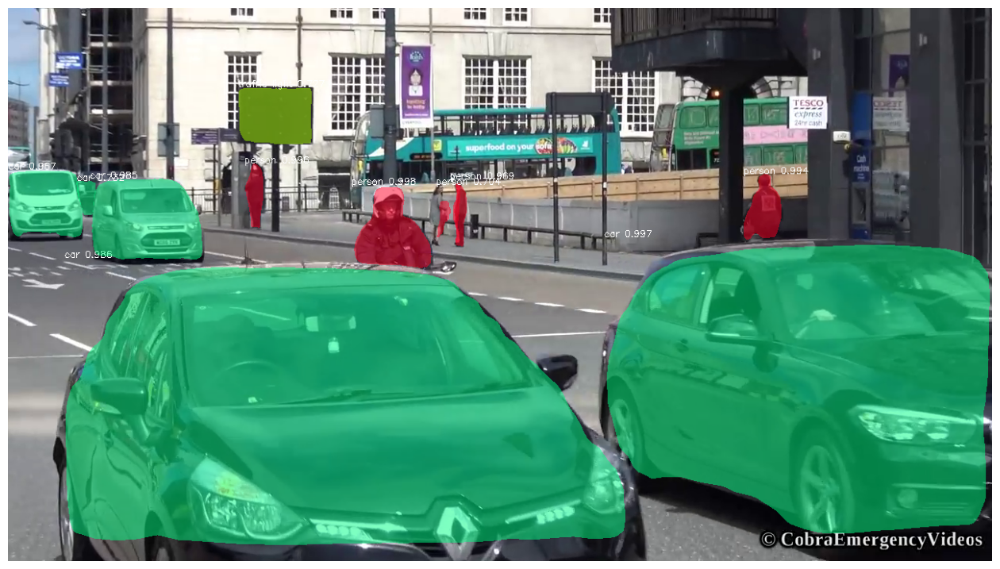

Displaying frame 50


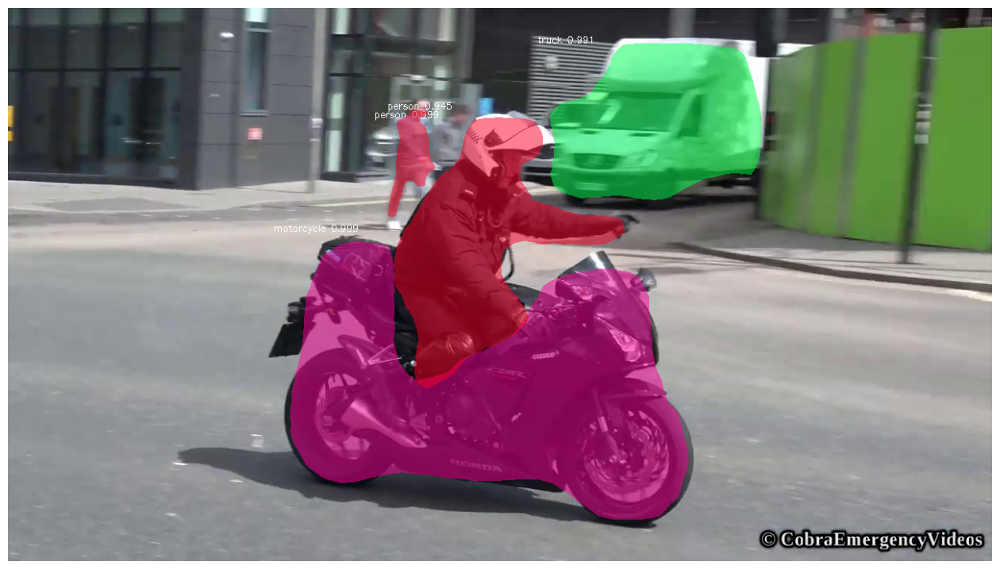

Displaying frame 100


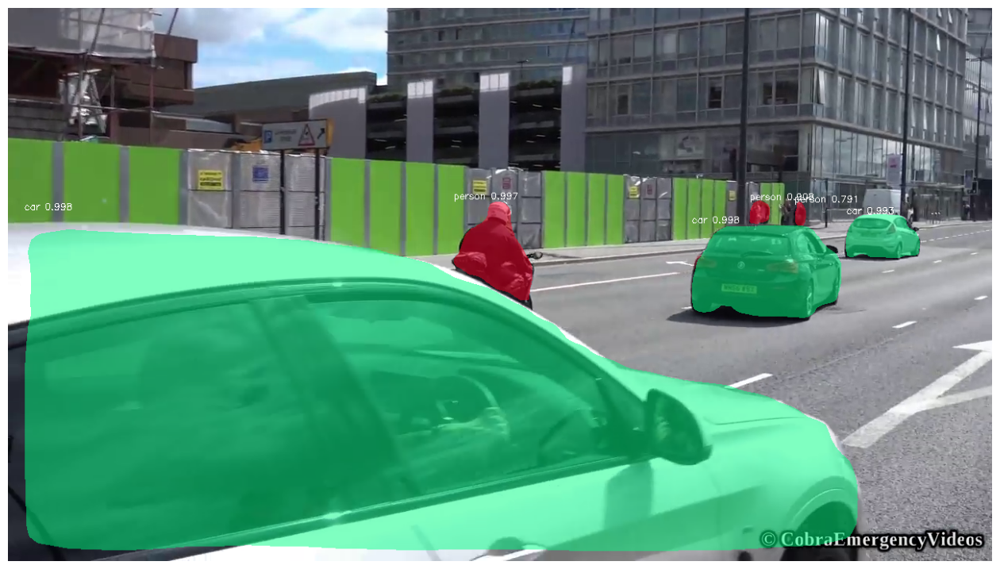

Displaying frame 150


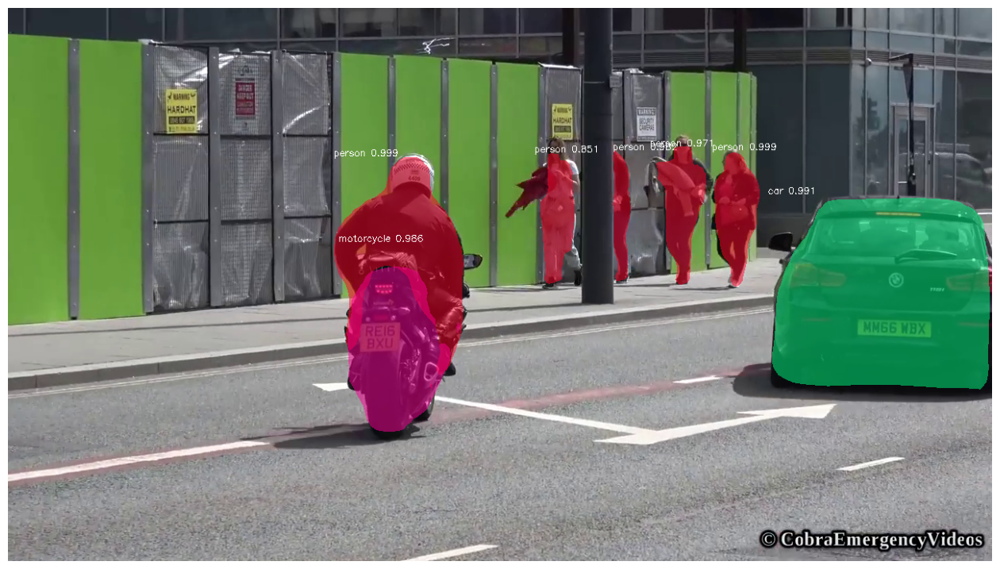

Displaying frame 200


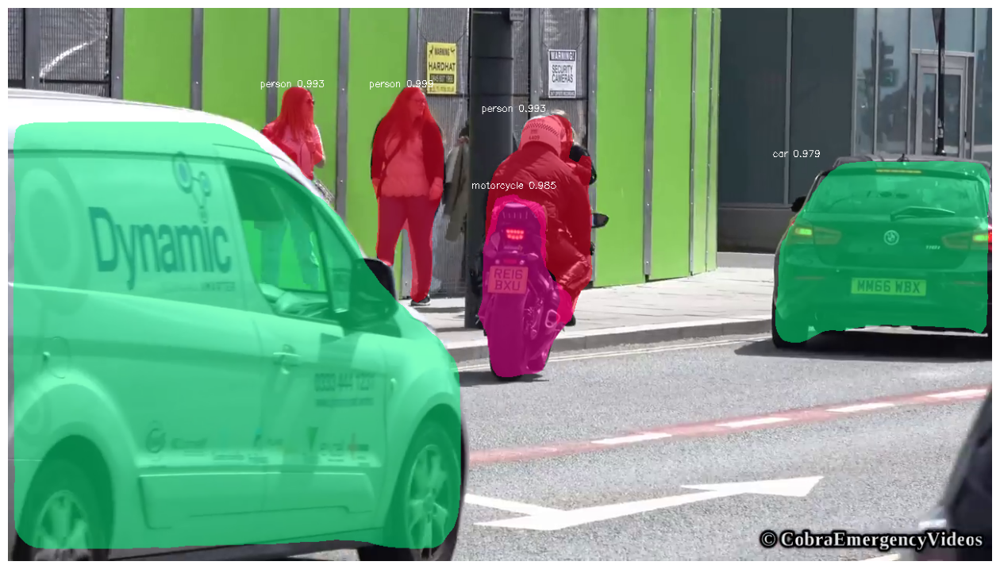

Stopping after processing 200 frames.


In [30]:
while cv2.waitKey(1) < 0:  # OpenCV waits for a key press; loop runs indefinitely until stopped
    connected, frame = capture.read()  # Read a frame from the video

    if not connected:  # Exit loop if the video ends or frame is not retrieved
        break

    # Perform object detection on the frame
    results = network.detect([frame], verbose=0)
    r = results[0]  # Process one frame at a time

    # Overlay detected objects (bounding boxes, masks, class labels)
    processed_frame = video_functions.display_instances(
        frame, r['rois'], r['masks'], r['class_ids'], class_names, r['scores'], colors=colors
    )

    # Always display the first processed frame, then every 'frame_show_interval' frame
    if current_frame == 0 or current_frame % frame_show_interval == 0:
        print(f"Displaying frame {current_frame}")
        show(processed_frame)

    # Stop processing after a certain number of frames (adjustable)
    if current_frame >= max_frames:  # max_frames limits how much of the video is processed
        print(f"Stopping after processing {max_frames} frames.")
        break

    current_frame += 1

    # Convert processed frame from BGR to RGB and save it
    save_video.write(cv2.cvtColor(processed_frame, cv2.COLOR_BGR2RGB))

# Release video writer to free memory
save_video.release()

### 9(D). Display the segmented .mp4 vile

In [31]:
from IPython.display import display, Video

# video_path = "/content/TrafficPolice_result_seg.mp4"  # Update with your actual video path
display(Video(saved_video_path, embed=True))